In [27]:
import os
import numpy as np
from preprocessing import *
from equalization import *
import matplotlib.pyplot as plt
import IPython.display as ipd
from scipy.signal import butter, lfilter, freqz
%matplotlib inline

In [2]:
files = full_file_scraper('../Downloads/admiral_audio')

In [4]:
files

['../Downloads/admiral_audio/09_LeadVoxDouble2.wav',
 '../Downloads/admiral_audio/02_Kick2.wav',
 '../Downloads/admiral_audio/06_Sample.wav',
 '../Downloads/admiral_audio/07_LeadVox.wav',
 '../Downloads/admiral_audio/03_Snare.wav',
 '../Downloads/admiral_audio/10_Scream.wav',
 '../Downloads/admiral_audio/Readme.txt',
 '../Downloads/admiral_audio/05_Hat2.wav',
 '../Downloads/admiral_audio/04_Hat1.wav',
 '../Downloads/admiral_audio/01_Kick1.wav',
 '../Downloads/admiral_audio/08_LeadVoxDouble1.wav']

In [3]:
lead_vox = files[3]

In [4]:
kick = files[-2]

In [5]:
# x, fs = librosa.load(lead_vox, sr=44100)
x = Signal(lead_vox, n_fft=1024, window_size=1024, hop_length=1024)

In [15]:
x_sig = x.signal

In [6]:
k = Signal(kick, n_fft=1024, window_size=1024, hop_length=1024)
k.set_chunk(seconds=5)

In [7]:
x.set_chunk(seconds=5)

In [8]:
x.chunk_fft.shape

(513, 28)

In [9]:
x.fft.shape

(513, 6000)

In [10]:
X_avg = np.mean(x.fft, axis=1)

In [11]:
K_avg = np.mean(k.fft, axis=1)

In [12]:
freqs = np.array([i * x.sr / x.fft.shape[0] for i in range(x.fft.shape[0])])

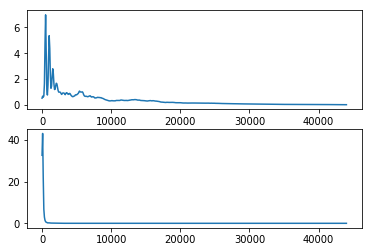

In [13]:
fig, axs = plt.subplots(2)
axs[0].plot(freqs, X_avg)
axs[1].plot(freqs, K_avg)

In [14]:
x_rolloff = librosa.feature.spectral_rolloff(x.signal, sr=x.sr, n_fft=x.n_fft, hop_length=x.hop_length, 
                         win_length=x.window_size, roll_percent=0.95)

array([[16838.96484375, 14599.51171875, 12790.72265625, ...,
        13910.44921875, 13738.18359375, 13565.91796875]])

In [52]:
b = librosa.feature.spectral_rolloff(k.signal, sr=x.sr, n_fft=x.n_fft, hop_length=x.hop_length, 
                         win_length=x.window_size, roll_percent=0.95)
b_active = b[0, np.argwhere(b > 0).flatten()]
b_avg = np.mean(b_active)
b_avg

2134.6943381721967

In [22]:
bins = [0, 300, 1200, 2400, 5000, 10000, 20000]

In [23]:
def butter_filter(cutoff, sr, order, btype):
    nyq = 0.5 * sr
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype=btype, analog=False)
    return b, a

def apply_bfilter(signal, cutoff, sr, order, btype):
    b, a = butter_filter(cutoff, sr, order, btype)
    y = lfilter(b, a, signal)
    return y

def compute_energy_percent(X_avg, freqs, bins):
    total_energy = np.sum(X_avg)
    energy_percents = []
    for i in range(len(bins)-1):
        arr = np.argwhere((freqs >= bins[i]) & (freqs < bins[i+1])).flatten()
        bin_sum = np.sum([X_avg[i] for i in arr])
        energy_percent = bin_sum / total_energy
        energy_percents.append(energy_percent)
    return np.array([energy_percents])

def compute_rolloff(x, fs, n_fft, hop_length, win_length, roll_percent):
    rolloffs = librosa.feature.spectral_rolloff(x, sr=x.sr, n_fft=n_fft, hop_length=hop_length, 
                         win_length=win_length, roll_percent=roll_percent)
    r_active = rolloffs[0, np.argwhere(b > 0).flatten()]
    r_avg = np.mean(r_active)
    return r_avg

In [37]:
compute_energy_percent(K_avg, freqs, bins)

array([[0.9218981 , 0.06346282, 0.00739514, 0.00264051, 0.00216505,
        0.00150348]], dtype=float32)

In [28]:
y = apply_bfilter(x_sig, 300, x.sr, 2, 'highpass')

In [54]:
yk = apply_bfilter(k.signal, 2134.69, k.sr, 2, 'lowpass')

In [55]:
ipd.Audio(yk[0:k.sr*20], rate=x.sr)

In [57]:
ipd.Audio(k.signal[0:k.sr*20], rate=x.sr)

In [40]:
ipd.Audio(k.signal[0:k.sr*20], rate=x.sr)

In [30]:
ipd.Audio(y[0:x.sr*20], rate=x.sr)

In [58]:
mixed = 0.5*y + 0.5*yk[:x.signal.shape[0]]

In [42]:
original = 0.5*x.signal + 0.5*k.signal[:x.signal.shape[0]]

In [33]:
k.signal.shape, x.signal.shape

((7257756,), (6143143,))

In [59]:
ipd.Audio(mixed, rate=x.sr)

In [43]:
ipd.Audio(original, rate=x.sr)